<a href="https://colab.research.google.com/github/salemeid/dog_vision/blob/main/dog_breed_img_rec.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# !unzip '/content/drive/MyDrive/dog_vision/dog-breed-identification.zip' -d '/content/drive/MyDrive/dog_vision/'

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import tensorflow_hub as hub

In [3]:
print("tensorflow version", tf.__version__)

tensorflow version 2.7.0


In [4]:
print("tesnsorflow version", hub.__version__)

tesnsorflow version 0.12.0


In [5]:
print("GPU","avaliable" if tf.config.list_physical_devices("GPU") else "not avaliable")

GPU avaliable


In [6]:
# This is a markdownM

In [7]:
labels_csv = pd.read_csv("drive/MyDrive/dog_vision/labels.csv")

In [8]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [9]:
labels_csv.describe()

,id,breed
count,10222,10222
unique,10222,120
top,e2d770fe32772edb9dba937c009f3e4d,scottish_deerhound
freq,1,126


In [10]:
labels_csv['breed'].value_counts()

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
brabancon_griffon        67
golden_retriever         67
komondor                 67
briard                   66
eskimo_dog               66
Name: breed, Length: 120, dtype: int64

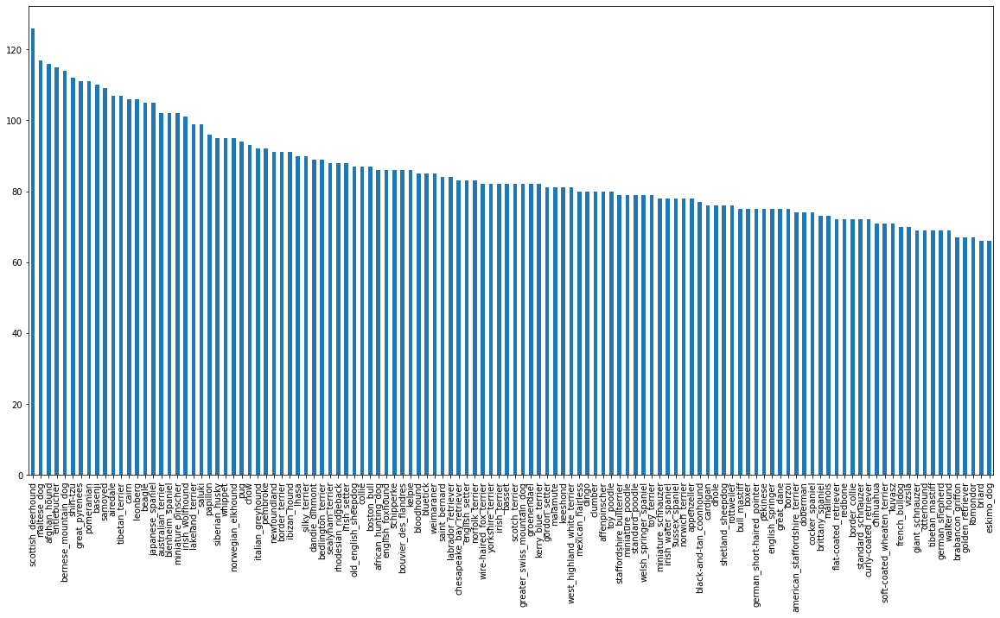

In [11]:
labels_csv['breed'].value_counts().plot.bar(figsize=(20,10))

In [12]:
labels_csv['breed'].value_counts().mean()

85.18333333333334

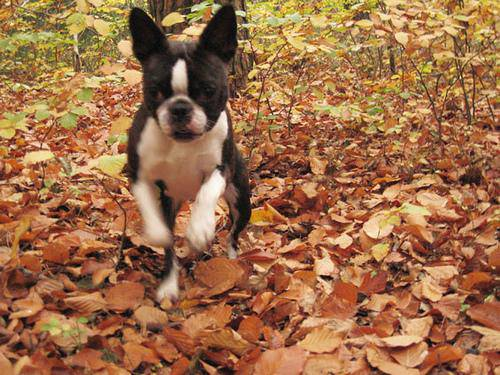

In [13]:
from IPython.display import Image
Image("drive/MyDrive/dog_vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

# New section

In [14]:
# create filenames list with label datas
filenames = ["drive/MyDrive/dog_vision/train/" + fname +".jpg" for fname in labels_csv["id"]]
filenames

['drive/MyDrive/dog_vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/dog_vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/dog_vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/dog_vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/dog_vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/dog_vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/dog_vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/dog_vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/dog_vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/dog_vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg',
 'drive/MyDrive/dog_vision/train/004396df1acd0f1247b740ca2b14616e.jpg',
 'drive/MyDrive/dog_vision/train/0067dc3eab0b3c3ef0439477624d85d6.jpg',
 'drive/MyDrive/dog_vision/train/00693b8bc2470375cc744a6391d397ec.jpg',
 'drive/MyDrive/dog_vision/train/006cc3ddb9dc1bd827479569fcdc52d

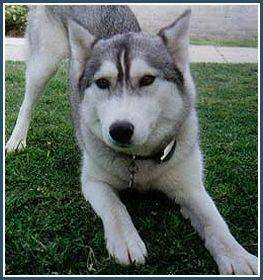

In [15]:
Image("drive/MyDrive/dog_vision/train/1699a179453b177a5e895c5b5ecb3624.jpg")

In [16]:
# check file names number with actual number of files

import os

if len(os.listdir("drive/MyDrive/dog_vision/train")) == len(filenames):
  print("files match file counts let's proceed")
else:
  print("filenames no match")

files match file counts let's proceed


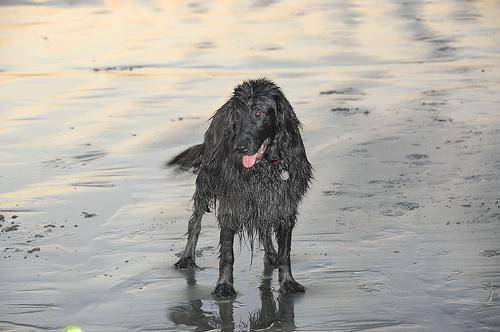

In [17]:
Image(filenames[2022])

In [18]:
labels_csv["breed"][2022]

'flat-coated_retriever'

In [19]:
# prepare labels
labels = labels_csv["breed"].to_numpy()
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [20]:
len(labels)

10222

In [21]:
if len(labels) == len(filenames):
  print("match")
else:
  print("No match,check data directory")

match


In [22]:
#find the unique label values.

unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [23]:
len(unique_breeds)

120

In [24]:
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [25]:
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [26]:
len(boolean_labels)

10222

In [27]:
# example turning boolean array into integar
print(labels[0])
print(np.where(unique_breeds == labels[0])) # index where label appears
print(boolean_labels[0].argmax()) # index where label appear in boolean array
print(boolean_labels[0].astype(int)) # turning into integer

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [28]:
# create validation set.

# setup X, y variables
X = filenames
y = boolean_labels

In [29]:
len(X)

10222

In [30]:
# set number of images to use for experimenting
# hyper parameters are in capital
NUM_IMAGES = 5000 #@param {type:"slider", min:1000, max:10000, step:1000}

In [31]:
from sklearn.model_selection import train_test_split


X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],y[:NUM_IMAGES],test_size=0.2,random_state=79)

In [32]:
len(X_train),len(y_train),len(X_val),len(y_val)

(4000, 4000, 1000, 1000)

## Preprocessing Images (Turning images into tensors)

To preprocess our images into tensors we are going to write a function which does a few things:
1. Take an image filepath as input
2. Use tensorflow to read the file and save it to a variable'image'
3. turn our image (a jpg) into tensors
4. resize the image tobe a shape of (224,224)
5. return the modified image

In [33]:
# conver image to Numpy array
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape
# result is a color channel (RGB)

(257, 350, 3)

In [34]:
image

array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  53],
        [ 97,  88,  49],
        [120, 111,  72]]

In [35]:
image.max(),image.min()

(255, 0)

In [36]:
tf.constant(image)
# this is how image looks like as a tensor

<tf.Tensor: shape=(257, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  5

Now we ahve seen what an image looks like in a tensor , let's make a function to preprocess them. 
Take an image filepath as input
Use tensorflow to read the file and save it to a variable'image'
turn our image (a jpg) into tensors
resize the image tobe a shape of (224,224)
return the modified image

In [37]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path,img_size=IMG_SIZE):
  """
  Take an image file path an turn the image into a Tensor
  """

  # read in an image file
  image = tf.itensor = tf.io.read_file(image_path)
  # turn the jped image into numerical tesor iwth 3 co.or channels (red,gren,blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the color channel values from 0-255 to 0-1 values (normalization)
  image = tf.image.convert_image_dtype(image,tf.float32)
  # resize the timage to our desired (224,224)
  image = tf.image.resize(image,size=[IMG_SIZE, IMG_SIZE])

  return image

## Turning our data into batches
minibatches is required to fit data into memory , defualt is 32 images at a time.

we pass data in form of tupple (image, label)

In [45]:
# create a simple function to return a tuple (image,label)

def get_image_label(image_path, label):

  image = process_image(image_path)
  return image, label

In [46]:
(process_image(X[10],y[10]))

<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
array([[[0.41753423, 0.38224012, 0.40184796],
        [0.4316044 , 0.39631027, 0.4159181 ],
        [0.40602714, 0.37879497, 0.3957155 ],
        ...,
        [0.19028023, 0.17067239, 0.18635866],
        [0.28062278, 0.26101494, 0.2767012 ],
        [0.28965282, 0.27004498, 0.28573126]],

       [[0.36733648, 0.33204237, 0.3516502 ],
        [0.3150591 , 0.27976498, 0.29937282],
        [0.29561085, 0.26837867, 0.2852992 ],
        ...,
        [0.23583163, 0.21230222, 0.22014536],
        [0.2812507 , 0.25772128, 0.2655644 ],
        [0.26320195, 0.23967254, 0.24751568]],

       [[0.40703085, 0.3717367 , 0.3907143 ],
        [0.46396694, 0.42867282, 0.4476504 ],
        [0.5020599 , 0.47482777, 0.491118  ],
        ...,
        [0.27574417, 0.24076518, 0.24374136],
        [0.30945447, 0.27447549, 0.27745166],
        [0.25501153, 0.22003253, 0.22300872]],

       ...,

       [[0.26359692, 0.28712633, 0.24728043],
        [0.26

Now we have got a awy to turn our data into tuples of tensors in the form of (image, label, let's make a function to turn all of our datat (X & y) into batches

In [52]:
# Define the batch size, 32 is a good start

BATCH_SIZE = 32

# Create a fucntion to turn data into batches.

def  create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Create batches of data out of images (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  also accept test data as input (no label).
  """

  # if data is test we don't have labels
  if test_data:
    print("Create test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths no labels
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # if data is valid set we don't shuffle it.
  elif valid_data:
    print("Creating validation data batches...")
    data  = tf.data.Dataset.from_tensor_slices((tf.constant(X),tf.constant(y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into tensors.
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),tf.constant(y)))
    # shuffle pathnames and labels 
    data = data.shuffle(buffer_size=len(X))
    # create (image, label ) tuples . 
    data = data.map(get_image_label)
    # turn the traini data into batches.
    data_batch = data.batch(BATCH_SIZE)
    return data_batch


In [48]:
# Crateing training and validation data batches

train_data = create_data_batches(X_train,y_train)
val_data = create_data_batches(X_val,y_val,valid_data=True)

Creating training data batches...
Creating validation data batches...


In [49]:
train_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))

In [50]:
val_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))

## Visualizing data batches

Our data is now in batches, however, these can be alittle hard to understand/comprehend

In [ ]:
import matplotlib.pyplot as plt

def show_25_images(images,labels):
  """
  Display a plot of 25 images and their labels from a data batch
  """

  #setup figure
  plt.figure(figsize=(10,10))
  #loop through 25 (for displaying 25 images)
  for i in range(25):
    ax = plt.subplot(5,5,i+1)
    plt.imshow(images[i])
    # add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()]) 
    plt.axis("off")

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())

In [ ]:
train_images, train_labels

(array([[[[0.26908264, 0.2965336 , 0.26516107],
          [0.27783614, 0.30528712, 0.27391458],
          [0.2944328 , 0.32188377, 0.29051122],
          ...,
          [0.25882354, 0.24313727, 0.20000002],
          [0.24373254, 0.23648468, 0.17587532],
          [0.25248605, 0.2485645 , 0.17797625]],
 
         [[0.26516107, 0.29261205, 0.2612395 ],
          [0.27391458, 0.30136555, 0.269993  ],
          [0.28690478, 0.31435576, 0.2829832 ],
          ...,
          [0.2506653 , 0.23497902, 0.19184177],
          [0.23196784, 0.22471997, 0.16411062],
          [0.24072136, 0.23679979, 0.16621155]],
 
         [[0.27058825, 0.29803923, 0.26666668],
          [0.28116247, 0.30861345, 0.2772409 ],
          [0.29051122, 0.3179622 , 0.28658965],
          ...,
          [0.23529413, 0.22352943, 0.18823531],
          [0.2307773 , 0.22471997, 0.17195375],
          [0.23287822, 0.23679979, 0.17405468]],
 
         ...,
 
         [[0.16712186, 0.12006304, 0.03378852],
          [0.17195

In [ ]:
len(train_images), len(train_labels)

(32, 32)

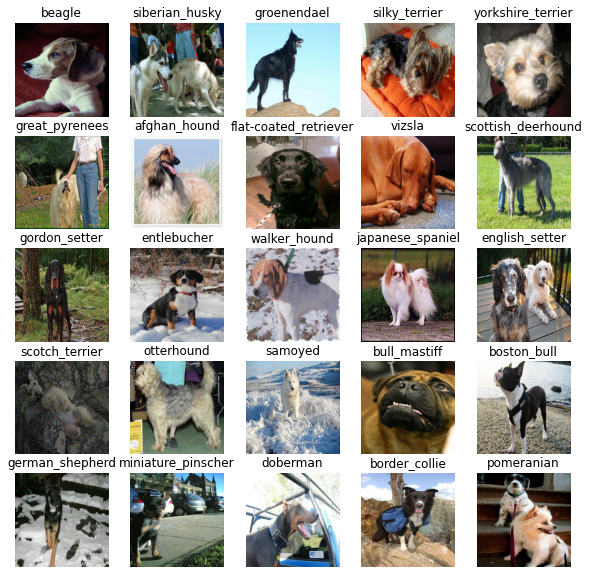

In [ ]:
# now let's visualize the datat in the training batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images,train_labels)

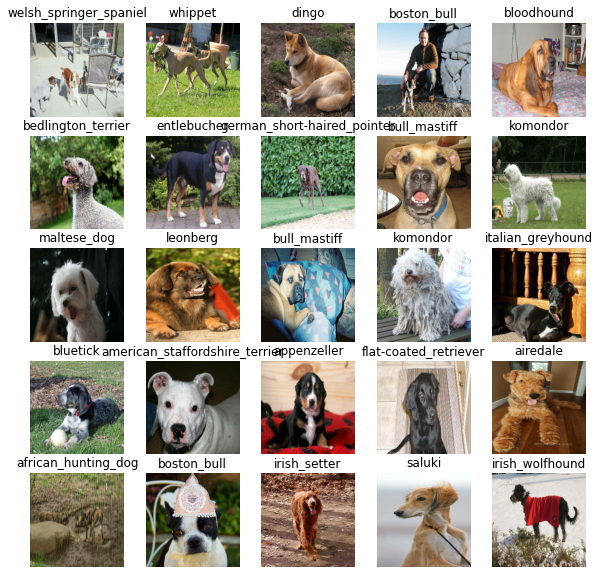

In [ ]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building a model

before we buidl a model , therer are a few things we need to define:
* The input shape ( our images shape, in the form of tensors) to our model.
* The output shape (image labels, in the form of tensors) of our model.
* The URL of the model we want to use from tensorflow https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [ ]:
# setup input shape to the model

INPUT_SHAPE = [None,IMG_SIZE, IMG_SIZE, 3] # batch, height, widdth, color channels

# setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)

# setup model URL from TensorFlow Hub
MODEL_URL = 'https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5'


Input, Output and model URL are set , now we can put them into keras deep learning model

Knowing this, let's create function which:
* Takes the input shape, output shape and the model we've chosen as parameters.
* Defines the layers in a Keras model in sequential fashion (do this, than that than data)
* Compiles the model (says it should be evaluated and improved).
Builds the model(tells the model the input shape it will be getting ).
* Return the model.

All of these steps can be found in : https://www.tensorflow.org/guide/keras/sequential_model


In [ ]:
# Create a function which buidl a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # setup model layers
  model = tf.keras.Sequential([
                              hub.KerasLayer(MODEL_URL),
                              tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                                                    activation="softmax") # layer2 (output)
  ])

  # compile the model 
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # BUild the model
  model.build(INPUT_SHAPE)

  return model


In [ ]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating callback
Callbacks are helper functions a model can use during traingng to do such tings as save its progress, check it's progress or stop training early if a model stops improving.

We'll create two callbacks, one for TesorBaord which helps track our model progress and another for early stopping which prevents our model from training for too long and over fitting

## TesnorBoard Callback
To setup a TesnorBoard callback, we nned to do 3 things:
1. Loadthe TensorBOard notebook extension✅
2. Create a TesnorBoard callback whihc is able to save logs in directory and pass it to our model's `fit()` function.
3. Visualize our models training logs with `%tesnorboard` magic function( we will do this after model training).

In [ ]:
# Load Tesnor board note book extesion
%load_ext tensorboard

In [ ]:
import datetime

# Create a function to build a TensorBoard callback.
def create_tensorboard_callback():
  # Create a log directory for storing Tensorboard logs.
  logdir = os.path.join("drive/MyDrive/dog_vision/logs",
                        # make log everytime we run model
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)


### Early Stopping Callback
 Early stopping prevents our model from overfitting . 
 https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping
 

In [ ]:
# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

## Training a model (on  subset data)

Our first model is oly going to train on 1000 images to make sure everything is working.

In [ ]:
NUM_EPOCHS = 100 #@param {type:"slider", min: 10 , max:100, steps:10}

In [ ]:
#Check to make sure we are still running on a GPU
print("GPU", "avaliable!!" if tf.config.list_physical_devices("GPU") else "not avaliable!")

GPU avaliable!!


Let's create a function which train a model.

* Create a model using `create_model()`
* Setup a TensorBoard callback using `create_tesnorboard_callback()`
* Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for (`NUM_EPOCHS`) and the callback we'd like to use.
* Return the model

In [ ]:
# Build a function to train nd return a trained model. 

def train_model():
  """
  Trains a given model and return the trained version.
  """

  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard,early_stopping])
  return model

In [ ]:
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
125/125 [==============================] - 116s 189ms/step - loss: 2.1683 - accuracy: 0.5125 - val_loss: 0.9602 - val_accuracy: 0.7400
Epoch 2/100
125/125 [==============================] - 23s 187ms/step - loss: 0.4679 - accuracy: 0.8823 - val_loss: 0.7792 - val_accuracy: 0.7620
Epoch 3/100
125/125 [==============================] - 23s 182ms/step - loss: 0.2291 - accuracy: 0.9590 - val_loss: 0.7385 - val_accuracy: 0.7950
Epoch 4/100
125/125 [==============================] - 22s 176ms/step - loss: 0.1337 - accuracy: 0.9835 - val_loss: 0.7327 - val_accuracy: 0.7760
Epoch 5/100
125/125 [==============================] - 23s 184ms/step - loss: 0.0872 - accuracy: 0.9937 - val_loss: 0.7244 - val_accuracy: 0.7800
Epoch 6/100
125/125 [==============================] - 23s 185ms/step - loss: 0.0635 - accuracy: 0.9960 - val_loss: 0.7342 - val_accuracy: 0.7800


### Checking the TensorBoard logs

after training our model , we can visualize it's performance by checking the tensorbaord logs.

The tensorbaord magic function `%tensorboard` will access the logs directory we created earlier and visualize it's contents

In [ ]:
%tensorboard --logdir drive/MyDrive/dog_vision/logs

<IPython.core.display.Javascript object>

## Making and evaluation prediction using a trained model

Before we go for full data , let's see some other ways we can evaluate our model. Because although accuracy is a pretty good indicator of how our model id doing. it would be even better if we could see it in action

Making predictions with a trained model is as calling `predict()` on it and passing it data in the same foramt the model was trained on

In [ ]:
# Make prediction on the validation data 

predictions = model.predict(val_data, verbose=1) # verbose to show progress
predictions

32/32 [==============================] - 6s 159ms/step


array([[9.5915479e-05, 4.2150277e-06, 1.9101766e-05, ..., 7.4950018e-04,
        5.5212260e-04, 1.4892042e-05],
       [5.7689329e-07, 5.6736289e-06, 1.2715339e-05, ..., 9.9160469e-01,
        7.6783556e-07, 1.2671831e-07],
       [2.6258347e-08, 1.2594167e-07, 1.5538741e-06, ..., 2.3091839e-06,
        1.4052917e-07, 1.7586972e-08],
       ...,
       [5.6333792e-01, 1.4992752e-05, 4.7420276e-06, ..., 2.9477014e-06,
        3.5391568e-05, 9.1976154e-04],
       [2.9951236e-05, 1.8240947e-06, 6.1029259e-06, ..., 1.5314782e-04,
        1.5665355e-05, 4.1903218e-06],
       [4.8440681e-05, 9.1039310e-06, 2.1331500e-05, ..., 1.8053654e-05,
        5.7837483e-06, 5.1975931e-06]], dtype=float32)

In [ ]:
# check the prediction shape
predictions.shape

(1000, 120)

Making predictions with our model returns an array with a different value for each label.

In this case, making predictions on the validation data (1000 images) returns an array `(predictions)` of arrays, each containing 120 different values (one for each unique dog breed).

These different values are the probabilities or the likelihood the model has predicted a certain image being a certain breed of dog. The higher the value, the more likely the model thinks a given image is a specific breed of dog.

Let's see how we'd convert an array of probabilities into an actual label.

In [ ]:
# First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[9.59154786e-05 4.21502773e-06 1.91017662e-05 3.63424479e-05
 6.37429039e-05 2.73668684e-05 3.96683929e-04 4.23474098e-03
 8.63264874e-03 6.65786341e-02 1.43437883e-05 1.19391217e-07
 1.65541078e-05 4.90049087e-03 5.70494813e-05 1.05013147e-04
 2.29494049e-06 1.75179848e-05 4.46820981e-04 6.39962309e-07
 1.39858764e-06 9.42774568e-05 1.72115222e-04 1.20765617e-05
 2.58441339e-03 4.27466057e-06 2.65791346e-06 2.03606091e-04
 7.44346107e-06 8.42449026e-06 1.70409512e-05 2.92861194e-04
 4.86368604e-04 7.32936132e-06 1.20749263e-07 2.95341706e-05
 1.90172632e-05 8.82454333e-05 6.43643034e-06 2.69074255e-04
 2.02703639e-03 1.91091094e-05 6.13382654e-05 4.71784660e-05
 3.50561572e-06 1.21496116e-04 1.06932630e-05 8.27259908e-04
 3.05223352e-06 2.29364214e-05 3.73285693e-05 1.53328324e-06
 2.80548958e-03 2.95135076e-03 1.42122337e-06 1.64759264e-03
 4.53218294e-04 3.91349640e-05 6.03682702e-06 4.73513455e-06
 1.44805948e-04 1.46187749e-05 6.12363863e-07 1.30777107e-06
 5.93648001e-05 1.796640

Having this information is great but it would be even better if we could compare a prediction to its true label and original image.

To help us, let's first build a little function to convert prediction probabilities into predicted labels.

Note: Prediction probabilities are also known as confidence levels.

In [ ]:
# Turn predictions probablities into their respective label (easier to understand)

def get_pred_label(prediction_probablities):
  """
  Turns an array of prediction probablities into a label
  """
  return unique_breeds[np.argmax(prediction_probablities)]

pred_label = get_pred_label(predictions[0])
pred_label

'welsh_springer_spaniel'

Now we've got a list of all different prediction our model has made, we will do the same for the validation iamges and validaton labels.

remembr, the model hasn't trained on the validation data, during the `fit()` function, it only used the validation data to evaluate iteself. So we can use the validation images to viusally comapre our models predictions with the validation labels.

Since our validation data `(val_data)` is in batch form, to get a list of validation images and labels, we will have to unbatch it using `unbatch()` and then turn it into an iterator using as_numpy_iterator()

lets' make a small function to do so.

In [ ]:
# Create a function to unbatch a batched dataset

def unbatchify(data):
  """
  Takes a batched dataset of (image,label) Tensors and reutrn separate arrays 
  of images and labels
  """

  images = []
  labels = []

  # loop through unbatched data

  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels


# unbatchify the validation data

val_images, val_labels = unbatchify(val_data)
val_images[0],val_labels[0]

(array([[[0.28727984, 0.30802697, 0.21800464],
         [0.26329657, 0.28934303, 0.26044294],
         [0.2977441 , 0.32519507, 0.35719788],
         ...,
         [0.68775386, 0.68775386, 0.64069504],
         [0.6327119 , 0.63744277, 0.6036423 ],
         [0.6442915 , 0.6482131 , 0.61684054]],
 
        [[0.16331172, 0.18115611, 0.10459721],
         [0.17501134, 0.19854075, 0.18381736],
         [0.1699532 , 0.19717415, 0.23490176],
         ...,
         [0.6238159 , 0.6266783 , 0.5738947 ],
         [0.6054678 , 0.6131502 , 0.57049525],
         [0.6293069 , 0.6360909 , 0.59613115]],
 
        [[0.21207775, 0.22724092, 0.17004342],
         [0.2758409 , 0.29805487, 0.29762205],
         [0.20857896, 0.23210837, 0.28086537],
         ...,
         [0.5315896 , 0.5355112 , 0.47828084],
         [0.5248012 , 0.53336453, 0.47937447],
         [0.55341405, 0.5612572 , 0.5094277 ]],
 
        ...,
 
        [[0.28555042, 0.31692296, 0.36790335],
         [0.24614593, 0.27751848, 0.32849

Got it!

Now we have got ways to get:
* prediction labels
* Validation labels(truth labels)
* Validation images.

Let's make some functions to make these all ab it more visualize

More specifically, we want to be able to biew an image, its predicted labels and it's actual label(true label)

The first function we will create will :
* Take an array of prediction prbablitites, an array of truth labels, an array of images and an integer.
* Convert the prediction probablities to a predicted labels
* Plot the predicted label, its predicted prbablity, the truth label and target iamge on a single plot.

In [ ]:
def plot_pred(prediction_probabilities,labels, images, n=1):
  """
  View the predictions, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # get the pred label
  pred_label = get_pred_label(pred_prob)

  # plot iage and remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  #Change the color of the title depending on if the predictions is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

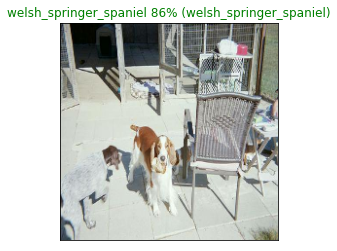

In [ ]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=0)

Nice! making functions to help visual your models resutls are really helpful in understanding how your model is doing.

since we are working with multiclass problem (120 different dog breeds), it would also be goo tosee what other guess our mode is making . mode specifically if our model predicts a certain label with 24% prbablitiy, what esle did it predict?

Lets buidl a fucntion to demonstrate. The function will:
* take and input of a prediction prbablities array, ag roudn truth labels array and an integer.
* Find the prejdicted labe using `get_pred_label()`
* Find the top 10:
  * Prediction prbablities indexes.
  * Prediction prbablites values.
  * Prediction labels
* Plot the top 10 prediction prbablity values and labels, coloring the true label green

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with the truth label for sample n.
  """

  pred_prob, true_label = prediction_probabilities[n], labels[n]

    # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

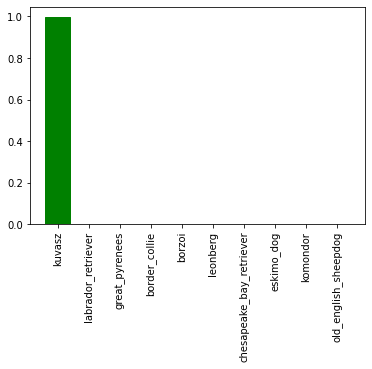

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=79)

Great! now we ahve got some functions to help us visualize our predictions and evalutes our model, let's check out a few.

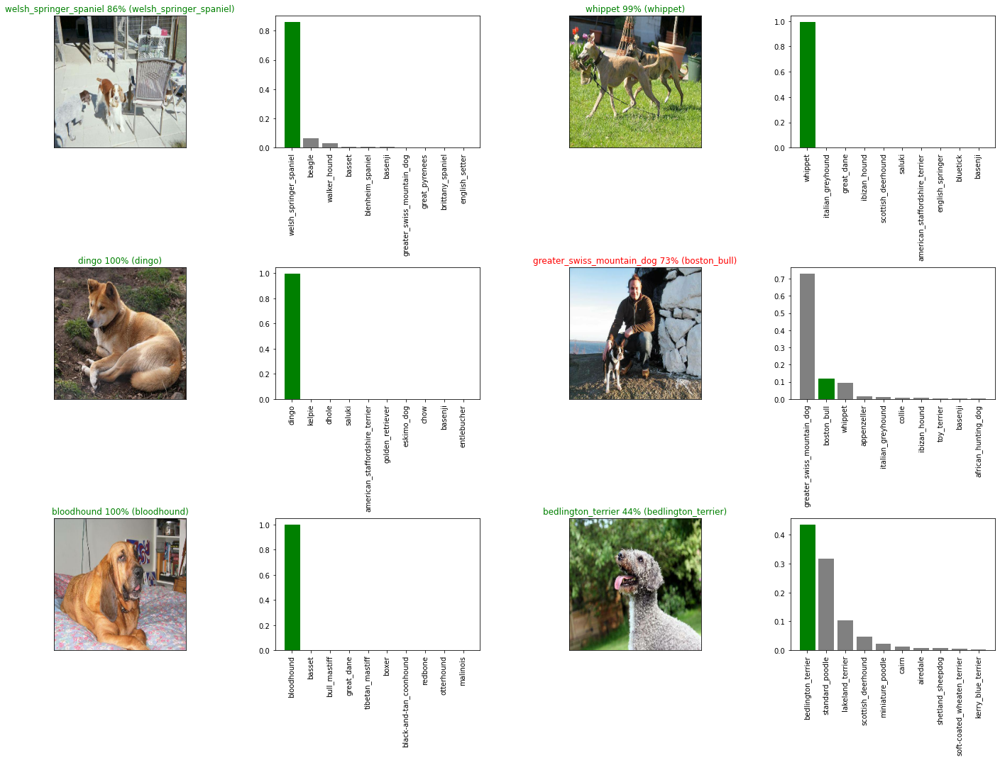

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and reloading a model


After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an entire saved Keras model is h5. So we'll make a function which can take a model as input and utilise the save() method to save it as a h5 file to a specified directory.

In [39]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/dog_vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

If we've got a saved model, we'd like to load it, let's create a function which can take a model path and use the tf.keras.models.load_model() function to load it into the notebook.

Because we're using a component from TensorFlow Hub (hub.KerasLayer) we'll have to pass this as a parameter to the custom_objects parameter.

In [40]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-Adam")

Saving model to: drive/MyDrive/dog_vision/models/20211229-06011640757711-1000-images-Adam.h5...


'drive/MyDrive/dog_vision/models/20211229-06011640757711-1000-images-Adam.h5'

In [ ]:
# Load our model trained on 1000 images
model_1000_images = load_model('drive/MyDrive/dog_vision/models/20211228-20591640725176-1000-images-Adam.h5')


Loading saved model from: drive/MyDrive/dog_vision/models/20211228-20591640725176-1000-images-Adam.h5


In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

32/32 [==============================] - 4s 132ms/step - loss: 0.7342 - accuracy: 0.7800


[0.7342140078544617, 0.7799999713897705]

In [ ]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

32/32 [==============================] - 5s 135ms/step - loss: 0.7552 - accuracy: 0.7680


[0.7551796436309814, 0.7680000066757202]

# Training a model (on the full data)

Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to X and all of the training labels to y. Let's check them out.

In [ ]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

There we go! We've got over 10,000 images and labels in our training set.

Before we can train a model on these, we'll have to turn them into a data batch.

The beautiful thing is, we can use our create_data_batches() function from above which also preprocesses our images for us (thank you past us for writing a helpful function).

In [ ]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches...


Our data is in a data batch, all we need now is a model.

And surprise, we've got a function for that too! Let's use create_model() to instantiate another model.

In [ ]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


Since we've made a new model instance, full_model, we'll need some callbacks too.

In [ ]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

To monitor the model whilst it trains, we'll load TensorBoard (it should update every 30-seconds or so whilst the model trains).

In [ ]:
%tensorboard --logdir drive/MyDrive/dog_vision/logs

Reusing TensorBoard on port 6006 (pid 6558), started 0:00:39 ago. (Use '!kill 6558' to kill it.)

<IPython.core.display.Javascript object>

Note: Since running the cell below will cause the model to train on all of the data (10,000+) images, it may take a fairly long time to get started and finish. However, thanks to our full_model_early_stopping callback, it'll stop before it starts going too long.

Remember, the first epoch is always the longest as data gets loaded into memory. After it's there, it'll speed up.

In [ ]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 59s 168ms/step - loss: 1.3379 - accuracy: 0.6666
Epoch 2/100
320/320 [==============================] - 51s 159ms/step - loss: 0.4035 - accuracy: 0.8790
Epoch 3/100
320/320 [==============================] - 53s 166ms/step - loss: 0.2372 - accuracy: 0.9364
Epoch 4/100
320/320 [==============================] - 52s 164ms/step - loss: 0.1554 - accuracy: 0.9651
Epoch 5/100
320/320 [==============================] - 55s 171ms/step - loss: 0.1052 - accuracy: 0.9800
Epoch 6/100
320/320 [==============================] - 57s 177ms/step - loss: 0.0773 - accuracy: 0.9865
Epoch 7/100
320/320 [==============================] - 54s 169ms/step - loss: 0.0588 - accuracy: 0.9922
Epoch 8/100
320/320 [==============================] - 57s 178ms/step - loss: 0.0467 - accuracy: 0.9943
Epoch 9/100
320/320 [==============================] - 57s 176ms/step - loss: 0.0365 - accuracy: 0.9960
Epoch 10/100
320/320 [==============================] - 56s 175m

## Saving and reloading the full model
Even on a GPU, our full model took a while to train. So it's a good idea to save it.

We can do so using our save_model() function.

Challenge: It may be a good idea to incorporate the save_model() function into a train_model() function. Or look into setting up a checkpoint callback.

In [ ]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/MyDrive/dog_vision/models/20211229-06241640759074-all-images-Adam.h5...


'drive/MyDrive/dog_vision/models/20211229-06241640759074-all-images-Adam.h5'

In [41]:
# Load in the full model 
loaded_full_model = load_model('drive/MyDrive/dog_vision/models/20211229-06241640759074-all-images-Adam.h5')

Loading saved model from: drive/MyDrive/dog_vision/models/20211229-06241640759074-all-images-Adam.h5


## Making prediction on the test dataset

Sine our model has been trained on images in the form of Tensor batches, tomake predictions ont he test data, we will have to get it into the same format.

luckily we create `create_data_batches()` earlies which can take a list of filenames as input and convert them into Tensor batches.

To make predicitons on the test data, we will :
* Get th test images filesnames.
* Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since there are no labels with the test images)
* Make a prediction array by passing the test data batches to the `predict()` function

In [42]:
# Load test image filenames (since we are using os.listdir()), these saleady have  .jpg

test_path = "drive/MyDrive/dog_vision/test/"

test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['drive/MyDrive/dog_vision/test/e55fa0c818f485f8e36edfb464c4f129.jpg',
 'drive/MyDrive/dog_vision/test/e27567e188000db387977cdb9bbdcf82.jpg',
 'drive/MyDrive/dog_vision/test/de9fc145601771b7a5b7e68822416fb5.jpg',
 'drive/MyDrive/dog_vision/test/e5a89b25873ada7aaafec0de1af86cb1.jpg',
 'drive/MyDrive/dog_vision/test/e021107c3f07749e5f5b389e57e21ded.jpg',
 'drive/MyDrive/dog_vision/test/e5ded7a736b3336729463af8d74a09c9.jpg',
 'drive/MyDrive/dog_vision/test/e69416b277bf04ba83a5f3586fe12f9b.jpg',
 'drive/MyDrive/dog_vision/test/e34654831e228ad3ac1d0c463e70caf6.jpg',
 'drive/MyDrive/dog_vision/test/ddd7f84a932ec7213b9c1f6de8c09262.jpg',
 'drive/MyDrive/dog_vision/test/e648a16d81b6441658b77bca0f1be4ee.jpg']

In [43]:
# how many test images are there ?

len(test_filenames)

10357

In [53]:
# Create test data batch

test_data = create_data_batches(test_filenames, test_data=True)

Create test data batches...


**Norw:** Since there are 10,000+ test images, making predictions could take a while, even on a GPU. so beware running the cell below may take up to an hour.

In [54]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,verbose=1)

324/324 [==============================] - 999s 3s/step


In [55]:
# Check out the test predictions
test_predictions[:10]

array([[2.3439721e-09, 7.3885856e-11, 1.4461609e-12, ..., 6.9161651e-12,
        7.6924218e-09, 2.7868975e-06],
       [3.8942943e-13, 1.7442939e-15, 5.6582974e-11, ..., 3.3395484e-13,
        2.8657743e-11, 1.6858725e-14],
       [4.1111035e-13, 3.6061273e-08, 4.4451605e-14, ..., 7.8921310e-08,
        9.3172359e-09, 1.4921465e-10],
       ...,
       [8.1825775e-11, 3.8854694e-13, 1.6548757e-10, ..., 2.3598629e-06,
        3.7173058e-09, 9.0539759e-10],
       [4.7993966e-13, 2.5108642e-07, 6.6569611e-10, ..., 7.8851313e-05,
        4.6139150e-09, 5.9602141e-12],
       [3.7177355e-11, 1.3203508e-11, 1.3392576e-06, ..., 3.3876850e-07,
        9.9906650e-08, 6.6376782e-10]], dtype=float32)

In [56]:
# Create pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [58]:
# Append test image ID's to predictions DataFrame
test_path = "drive/MyDrive/dog_vision/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e55fa0c818f485f8e36edfb464c4f129,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e27567e188000db387977cdb9bbdcf82,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,de9fc145601771b7a5b7e68822416fb5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e5a89b25873ada7aaafec0de1af86cb1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e021107c3f07749e5f5b389e57e21ded,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [59]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e55fa0c818f485f8e36edfb464c4f129,2.34397e-09,7.38859e-11,1.44616e-12,8.10403e-10,2.44193e-06,2.82735e-08,4.31627e-08,1.86332e-10,2.77796e-14,1.44991e-08,2.05445e-11,9.17994e-13,4.28742e-10,2.28036e-09,4.29706e-09,4.09164e-10,1.0741e-10,5.6986e-07,6.35321e-12,1.89286e-06,1.71195e-10,0.000743619,0.999204,3.35811e-10,5.89585e-11,1.27939e-07,9.8564e-13,1.81958e-12,4.78443e-10,3.33546e-09,2.76007e-08,1.08351e-10,4.44748e-10,2.54034e-12,3.2359e-12,3.56622e-10,5.26879e-12,2.42724e-11,1.55843e-09,...,7.98259e-10,1.28855e-10,3.15098e-12,2.39906e-11,2.40189e-09,7.11407e-08,6.16797e-13,1.12102e-09,3.69223e-07,5.53858e-08,6.40287e-11,2.77349e-06,1.90206e-10,3.11073e-14,6.08122e-11,1.97765e-08,1.92145e-12,2.30429e-12,1.65409e-08,1.0506e-11,8.34381e-09,2.50552e-11,1.34498e-08,1.41875e-09,3.69959e-07,9.07496e-10,6.10332e-09,2.65029e-09,3.90969e-10,3.88e-13,1.32988e-09,1.65254e-07,7.43536e-09,7.91782e-11,7.164e-11,1.08732e-09,4.02499e-11,6.91617e-12,7.69242e-09,2.7869e-06
1,e27567e188000db387977cdb9bbdcf82,3.89429e-13,1.74429e-15,5.6583e-11,7.97826e-16,7.8182e-12,6.24212e-11,1.92159e-11,6.16823e-06,1.15726e-13,2.54799e-10,5.33233e-14,1.62658e-11,2.80458e-12,1.878e-12,2.89963e-12,3.0159e-14,1.25529e-12,1.14631e-12,1.11286e-12,1.38052e-14,5.39571e-14,1.76967e-15,2.79322e-13,1.68206e-13,3.82666e-13,8.32226e-16,8.42377e-11,1.99198e-05,2.66336e-13,1.2027e-06,2.56404e-12,1.37183e-13,4.99547e-13,2.93714e-11,1.70766e-15,7.20576e-13,1.28979e-07,6.22909e-09,3.48509e-14,...,2.71529e-12,6.66815e-09,1.5846e-15,3.44477e-15,1.85162e-09,1.1465e-13,0.999972,4.81944e-12,4.62062e-14,1.01479e-10,5.47365e-14,1.02693e-14,1.3639e-12,5.21945e-14,3.40481e-11,8.02533e-08,3.51138e-10,9.76012e-15,1.47469e-13,3.63597e-10,1.36678e-12,8.38795e-11,2.20821e-09,7.1924e-12,9.73776e-15,4.90665e-14,1.46445e-14,1.50268e-15,1.02158e-16,3.54208e-14,1.34329e-12,6.12811e-10,3.94765e-14,2.27752e-14,4.3743e-14,1.90351e-11,5.29741e-12,3.33955e-13,2.86577e-11,1.68587e-14
2,de9fc145601771b7a5b7e68822416fb5,4.1111e-13,3.60613e-08,4.44516e-14,7.46703e-10,1.83462e-09,2.49469e-08,5.47781e-10,4.84359e-08,6.11483e-07,1.26627e-07,7.96132e-10,7.57169e-15,4.53879e-06,1.46354e-09,4.90784e-06,8.33605e-07,3.31347e-10,3.59357e-07,1.0876e-10,1.76873e-10,3.7543e-12,4.26117e-08,6.44696e-08,3.87076e-13,1.38212e-09,5.52804e-07,5.58006e-12,1.15815e-08,0.000184066,2.0194e-11,7.99007e-08,3.9437e-10,1.71366e-08,4.93707e-09,1.80922e-09,1.24865e-11,1.12388e-06,0.000155547,1.73299e-09,...,4.37868e-09,3.17612e-13,6.85198e-12,1.14476e-08,1.19209e-12,1.62423e-10,8.36533e-08,1.76007e-10,6.81946e-09,0.978358,0.0164697,1.97464e-07,3.11012e-08,9.51272e-05,4.87313e-12,5.3507e-11,2.07545e-12,1.76246e-10,1.29253e-11,1.67185e-10,2.10189e-08,1.18849e-09,3.36275e-08,2.51201e-08,1.53276e-10,8.67694e-08,1.95229e-08,2.63836e-10,2.38001e-10,6.47592e-12,1.78717e-10,2.53425e-12,9.16276e-07,1.20284e-05,1.90277e-08,3.19349e-08,1.38799e-13,7.892

In [61]:
preds_df.to_csv("drive/MyDrive/dog_vision/full_submission_1_mobilienetV2_adam.csv",
                 index=False)